## CREDIT CARD FRAUD DETECTION
- Build a machine learning model to identify fraudulent credit card transactions.
- Preprocess and normalize the transaction data, handle class
imbalance issues, and split the dataset into training and testing sets.
- Train a classification algorithm, such as logistic regression or random
forests, to classify transactions as fraudulent or genuine.
- Evaluate the model's performance using metrics like precision, recall,
and F1-score, and consider techniques like oversampling or
undersampling for improving results.

## About Dataset
#### Link - https://www.kaggle.com/datasets/mlg-ulb/creditcardfraud/data
### Context
It is important that credit card companies are able to recognize fraudulent credit card transactions so that customers are not charged for items that they did not purchase.
### Content
The dataset contains transactions made by credit cards in September 2013 by European cardholders.
This dataset presents transactions that occurred in two days, where we have 492 frauds out of 284,807 transactions. The dataset is highly unbalanced, the positive class (frauds) account for 0.172% of all transactions.

It contains only numerical input variables which are the result of a PCA transformation. Unfortunately, due to confidentiality issues, we cannot provide the original features and more background information about the data. Features V1, V2, … V28 are the principal components obtained with PCA, the only features which have not been transformed with PCA are 'Time' and 'Amount'. Feature 'Time' contains the seconds elapsed between each transaction and the first transaction in the dataset. The feature 'Amount' is the transaction Amount, this feature can be used for example-dependant cost-sensitive learning. Feature 'Class' is the response variable and it takes value 1 in case of fraud and 0 otherwise.

### Steps
#### Preparing the environment
1. Importing the necessary packages and modules
2. Reading the required files in a Data Frame
#### Data Preprocessing
3. Checking for missing values in the dataset
  - We see no missing values in most of the columns
  - There is only one missing value in the rest of the columns
4. Cleaning the missing values
  - We see that there is only one row with missing values in all the columns.
  - We can also notice that the target column also has a missing value in this row.
  - We can drop the row.
5. Checking for duplicate values
  - We see there 53 rows that are duplicated in our dataset.
  - Also the target column in all duplicated rows is of 'Class 0'.
  - Droping them as there are of very small count compared to the number of rows in our dataset.
6. Spliting the datset into train and validation set.
#### Exploratory Data Analysis (EDA)
7. Checking the relationship of the target variable against the other features.
  - After checking the visualisations for the distribution of data using scatter, box, boxen and dist plots, we conclude the following.
  - Columns V2, V3, V4, V7, V9, V10, V11, V12, V13, V16 and V17 seem to be significant
  - We also see a few outliers throughout the dataset
  - There seems to be skewness throughout
8. Performing Advanced EDA with Pandas Profiling and pairplot confirms the above observations
  - Additionally we can observe the below
    - There is very high data imbalance
    - There is high negative correlation between 'Time', 'V12' and 'V14'
    - There is a high correlation between 'V21' and 'V22'
    - There is no corellation greater that 75% in the dataset
    - There is no high auto corellation
    - If we have any computational issue, we can reduce the correlated features.
9. Checking the data imbalance through cisualisation, we can identify a clear data imbalance in the target column.
#### Data Preprocessing
10. Using random over sampling to treat the imbalance data set.


In [ ]:
# ! pip install pandas-profiling
# ! pip install pycaret
# ! pip install --upgrade scipy
# ! pip install --upgrade statsmodels
# ! pip install imbalanced-learn

import warnings
warnings.filterwarnings('ignore')

import matplotlib.pyplot as plt
import numpy as np
import os
import pandas as pd
import seaborn as sns
import statsmodels.api as sm

from imblearn.over_sampling import RandomOverSampler
from numba import jit, cuda
from ydata_profiling import ProfileReport
from pycaret.classification import *
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from statsmodels.formula.api import ols

sns.set()
%matplotlib inline

In [ ]:
# Reading the dataset as a dataframe

dataset_df = pd.read_csv('/05_creditcard.csv')
dataset_df.head()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,...,-0.018307,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,149.62,0.0
1,0,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,...,-0.225775,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,2.69,0.0
2,1,-1.358354,-1.340163,1.773209,0.379780,-0.503198,1.800499,0.791461,0.247676,-1.514654,...,0.247998,0.771679,0.909412,-0.689281,-0.327642,-0.139097,-0.055353,-0.059752,378.66,0.0
3,1,-0.966272,-0.185226,1.792993,-0.863291,-0.010309,1.247203,0.237609,0.377436,-1.387024,...,-0.108300,0.005274,-0.190321,-1.175575,0.647376,-0.221929,0.062723,0.061458,123.50,0.0
4,2,-1.158233,0.877737,1.548718,0.403034,-0.407193,0.095921,0.592941,-0.270533,0.817739,...,-0.009431,0.798278,-0.137458,0.141267,-0.206010,0.502292,0.219422,0.215153,69.99,0.0


#### Checking for missing values in the dataset

In [ ]:
dataset_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13954 entries, 0 to 13953
Data columns (total 31 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   Time    13954 non-null  int64  
 1   V1      13954 non-null  float64
 2   V2      13954 non-null  float64
 3   V3      13954 non-null  float64
 4   V4      13954 non-null  float64
 5   V5      13954 non-null  float64
 6   V6      13954 non-null  float64
 7   V7      13954 non-null  float64
 8   V8      13954 non-null  float64
 9   V9      13954 non-null  float64
 10  V10     13954 non-null  float64
 11  V11     13954 non-null  float64
 12  V12     13954 non-null  float64
 13  V13     13954 non-null  float64
 14  V14     13954 non-null  float64
 15  V15     13954 non-null  float64
 16  V16     13954 non-null  float64
 17  V17     13954 non-null  float64
 18  V18     13954 non-null  float64
 19  V19     13954 non-null  float64
 20  V20     13954 non-null  float64
 21  V21     13954 non-null  float64
 22

- We see no missing values in most of the columns
- There is only one missing value in the rest of the columns

In [ ]:
# Checking the missing values

dataset_df[dataset_df.isnull().any(axis = 1)]

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
13953,24759,-6.917152,5.854171,-1.652458,-1.488884,-0.833891,-0.344418,0.393789,0.379968,6.133597,...,-1.404681,-1.124694,0.174333,-0.528234,0.990685,-0.035875,1.071374,-0.168831,NaN,NaN


- We see that there is only one row with missing values in all the columns.
- We can also notice that the target column also has a missing value in this row.
- We can drop the row.

In [ ]:
# Drop rows containing NaN values in-place
dataset_df.dropna(inplace=True)

In [ ]:
dataset_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 13953 entries, 0 to 13952
Data columns (total 31 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   Time    13953 non-null  int64  
 1   V1      13953 non-null  float64
 2   V2      13953 non-null  float64
 3   V3      13953 non-null  float64
 4   V4      13953 non-null  float64
 5   V5      13953 non-null  float64
 6   V6      13953 non-null  float64
 7   V7      13953 non-null  float64
 8   V8      13953 non-null  float64
 9   V9      13953 non-null  float64
 10  V10     13953 non-null  float64
 11  V11     13953 non-null  float64
 12  V12     13953 non-null  float64
 13  V13     13953 non-null  float64
 14  V14     13953 non-null  float64
 15  V15     13953 non-null  float64
 16  V16     13953 non-null  float64
 17  V17     13953 non-null  float64
 18  V18     13953 non-null  float64
 19  V19     13953 non-null  float64
 20  V20     13953 non-null  float64
 21  V21     13953 non-null  float64
 22

In [ ]:
# Checking the data set

dataset_df.describe()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
count,13953.000000,13953.000000,13953.000000,13953.000000,13953.000000,13953.000000,13953.000000,13953.000000,13953.000000,13953.000000,...,13953.000000,13953.000000,13953.000000,13953.000000,13953.000000,13953.000000,13953.000000,13953.000000,13953.000000,13953.000000
mean,10120.112736,-0.235197,0.283888,0.846226,0.302903,-0.118679,0.128047,-0.157336,-0.016176,0.989459,...,-0.067941,-0.157402,-0.035600,0.011196,0.116957,0.035549,0.012711,0.002134,63.882442,0.004013
std,7738.910946,1.719446,1.394057,1.561289,1.500572,1.289526,1.320437,1.238618,1.262065,1.213306,...,0.873900,0.621813,0.499822,0.587229,0.427905,0.558309,0.399463,0.255715,177.887021,0.063227
min,0.000000,-27.670569,-34.607649,-24.667741,-4.657545,-32.092129,-23.496714,-26.548144,-23.632502,-7.175097,...,-11.468435,-8.593642,-19.254328,-2.512377,-4.781606,-1.338556,-7.976100,-3.575312,0.000000,0.000000
25%,2984.000000,-0.969733,-0.282744,0.407423,-0.623017,-0.717075,-0.624048,-0.616472,-0.182281,0.288101,...,-0.271770,-0.549720,-0.173814,-0.339656,-0.135903,-0.374626,-0.076862,-0.014862,5.490000,0.000000
50%,9086.000000,-0.319405,0.252845,0.961015,0.220137,-0.191573,-0.144198,-0.112094,0.016904,0.971387,...,-0.132302,-0.122777,-0.045042,0.060208,0.155162,-0.035782,-0.000968,0.016243,15.690000,0.000000
75%,17099.000000,1.162666,0.884662,1.607069,1.199038,0.351314,0.508506,0.421843,0.265522,1.654173,...,0.018685,0.228997,0.069744,0.392750,0.393032,0.375313,0.098500,0.072503,52.150000,0.000000
max,24759.000000,1.960497,10.558600,4.101716,11.927512,34.099309,21.393069,34.303177,10.535558,10.392889,...,22.614889,4.534454,13.876221,3.200201,5.525093,3.517346,8.254376,4.860769,7712.430000,1.000000


In [ ]:
dataset_df.shape

(13953, 31)

In [ ]:
# Checking for duplicate values before train test split

dataset_df.duplicated().sum()

53

In [ ]:
# Checking the rows with duplicate values

dataset_df[dataset_df.duplicated()]

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
33,26,-0.529912,0.873892,1.347247,0.145457,0.414209,0.100223,0.711206,0.176066,-0.286717,...,0.046949,0.208105,-0.185548,0.001031,0.098816,-0.552904,-0.073288,0.023307,6.14,0.0
35,26,-0.535388,0.865268,1.351076,0.147575,0.433680,0.086983,0.693039,0.179742,-0.285642,...,0.049526,0.206537,-0.187108,0.000753,0.098117,-0.553471,-0.078306,0.025427,1.77,0.0
113,74,1.038370,0.127486,0.184456,1.109950,0.441699,0.945283,-0.036715,0.350995,0.118950,...,0.102520,0.605089,0.023092,-0.626463,0.479120,-0.166937,0.081247,0.001192,1.18,0.0
114,74,1.038370,0.127486,0.184456,1.109950,0.441699,0.945283,-0.036715,0.350995,0.118950,...,0.102520,0.605089,0.023092,-0.626463,0.479120,-0.166937,0.081247,0.001192,1.18,0.0
115,74,1.038370,0.127486,0.184456,1.109950,0.441699,0.945283,-0.036715,0.350995,0.118950,...,0.102520,0.605089,0.023092,-0.626463,0.479120,-0.166937,0.081247,0.001192,1.18,0.0
221,145,-2.420413,1.947885,0.553646,0.983069,-0.281518,2.408958,-1.401613,-0.188299,0.675878,...,1.213826,-1.238620,0.006927,-1.724222,0.239603,-0.313703,-0.188281,0.119831,6.00,0.0
223,145,-2.419486,1.949346,0.552998,0.982710,-0.284815,2.411200,-1.398537,-0.188922,0.675695,...,1.213390,-1.238354,0.007191,-1.724175,0.239721,-0.313607,-0.187431,0.119472,6.74,0.0
1178,919,0.904289,-0.538055,0.396058,0.500680,-0.864473,-0.657199,0.027231,-0.029473,0.265447,...,-0.099460,-0.597579,-0.048666,0.551824,0.182934,0.402176,-0.081357,0.027252,158.00,0.0
1180,919,1.207596,-0.036860,0.572104,0.373148,-0.709633,-0.713698,-0.181105,0.011277,0.283940,...,-0.194591,-0.514717,0.089714,0.543768,0.240581,0.418921,-0.051693,-0.000085,1.00,0.0
1382,1074,-2.248488,-0.195670,0.026949,-0.525780,-0.238759,-0.033359,0.162196,0.928520,-0.424215,...,-0.032208,-0.745757,-0.243193,-0.821633,-0.030402,0.335838,-0.286998,-0.243768,158.00,0.0


In [ ]:
# Droping the duplicate rows

dataset_df.drop_duplicates(inplace = True)
dataset_df.duplicated().sum()

0

In [ ]:
dataset_df.shape

(13900, 31)

In [ ]:
# Spliting data into train and test

train_df, validation_df = train_test_split(dataset_df, train_size = 0.75, random_state = 1, stratify = dataset_df['Class'])
train_df.head(2)

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
4413,3767,1.411399,-0.667231,-0.909267,-1.620560,1.463402,3.272875,-1.177283,0.711705,0.360721,...,-0.281262,-0.895513,0.085829,0.919754,0.358940,-0.507827,-0.018947,0.014535,36.76,0.0
11646,19914,-1.034482,0.759945,1.344673,-1.554244,-0.532826,0.220303,-1.165552,-2.487095,0.054889,...,-1.371789,0.378573,-0.039743,-0.080777,0.070622,-0.440477,0.263666,0.179714,5.00,0.0


In [ ]:
validation_df.head(2)

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
6720,8416,-2.001242,-1.156224,0.943260,-3.358546,2.810339,2.606268,-1.403688,0.990516,2.713019,...,-0.022576,0.295244,-0.594091,1.036889,0.553745,-0.018595,0.371123,0.024736,58.85,0.0
9385,13745,-0.578420,0.464609,2.591404,0.643604,-0.088220,1.730814,-0.452627,0.691352,1.456464,...,0.327151,1.289857,0.050147,-0.700786,-0.451289,-0.224171,0.133582,0.032121,37.16,0.0


In [ ]:
train_df.shape

(10425, 31)

In [ ]:
validation_df.shape

(3475, 31)

#### Exploratory Data Analysis (EDA)

In [ ]:
# Visualising the data
# Since we plot all data and there is imbalance not able to visualise clearly

@jit(target_backend='gpu')
def viz1():
  numeric_cols = train_df.select_dtypes(include = np.number)
  col_names = list(numeric_cols.columns)
  col_index = 0
  plt_rows = 10
  plt_cols = 3

  fig, ax = plt.subplots(nrows = plt_rows, ncols = plt_cols, figsize = (20, 40))
  ax = ax.flatten()

  for i, ax in enumerate(ax):
      sns.scatterplot(y = train_df[col_names[col_index]], x = train_df.index, data = train_df, c = train_df['Class'], cmap = 'viridis', alpha = 0.5, ax = ax)
      ax.set_title(f'Subplot {i+1}')
      col_index += 1

  plt.tight_layout()
  plt.show()

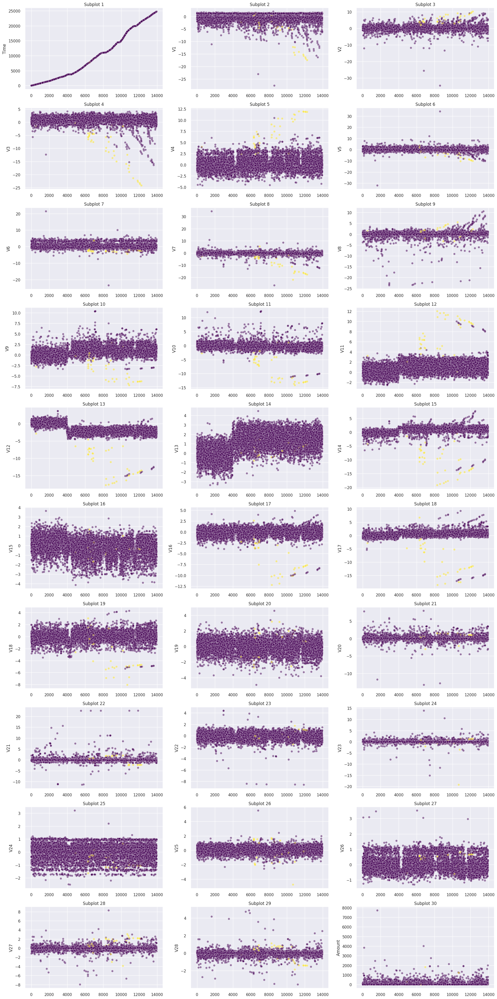

In [ ]:
viz1()

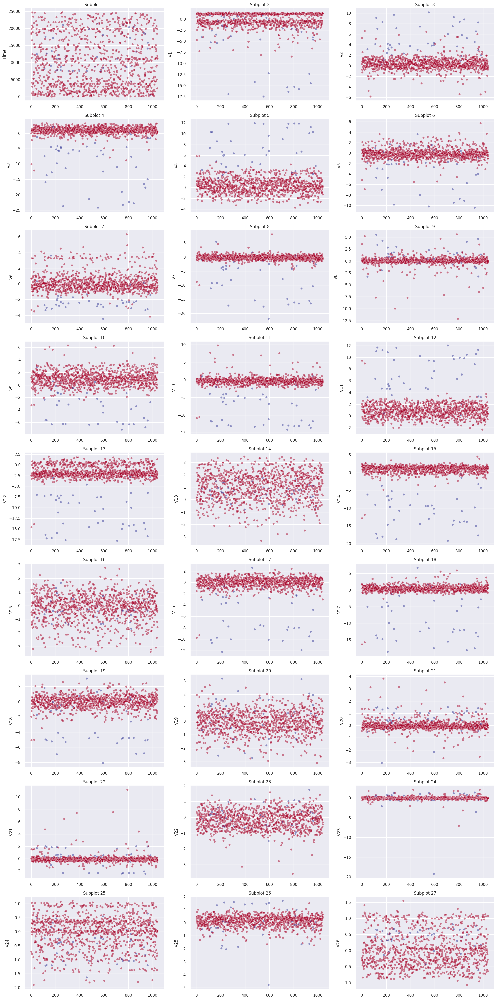

In [ ]:
# Visualising the data
# Visualising a sample of data to clearly distinguish to see significant variables

numeric_cols = train_df.select_dtypes(include = np.number)

genuine_trans = numeric_cols.loc[numeric_cols['Class'] == 0, :]
fraud_trans = numeric_cols.loc[numeric_cols['Class'] == 1, :]

genuine_trans_sub = genuine_trans.sample(n=1000, replace = False)

new_df = pd.concat([fraud_trans, genuine_trans_sub], axis = 0)
new_df = new_df.sample(frac = 1)
new_df.reset_index(drop = True, inplace = True)

column_names = list(numeric_cols.columns)
column_index = 0

plot_rows = 9
plot_cols = 3

fig, ax = plt.subplots(nrows = plot_rows, ncols = plot_cols, figsize = (20, 40))
ax = ax.flatten()

for i, ax in enumerate(ax):
    sns.scatterplot(y = new_df[column_names[column_index]], x = new_df.index, data = new_df, c = new_df['Class'], cmap = 'RdYlBu', alpha = 0.5, ax = ax)
    ax.set_title(f'Subplot {i+1}')
    column_index += 1

plt.tight_layout()
plt.show()

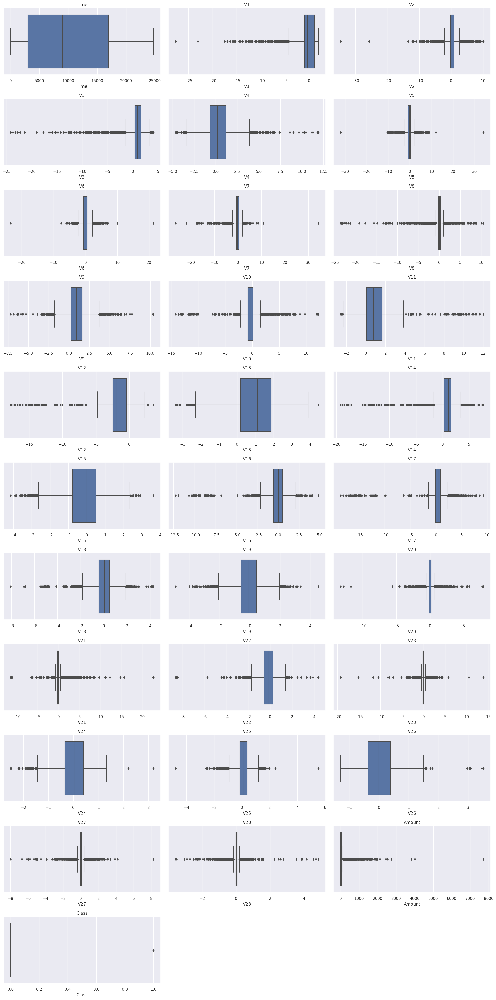

In [ ]:
# Checking for outliers using boxplots

plt.figure(figsize=(20, 40))

for col in train_df.select_dtypes(include=['number']).columns:
    plt.subplot(11, 3, train_df.columns.get_loc(col) + 1)  # Adjust the subplot layout as needed
    sns.boxplot(x=train_df[col])
    plt.title(col)

plt.tight_layout()
plt.show()

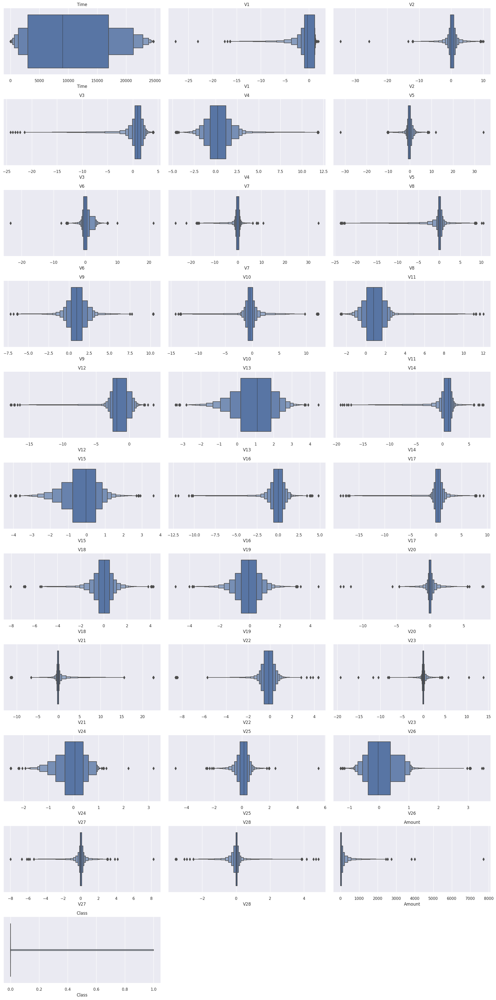

In [ ]:
# Checking for outliers using boxen plots

plt.figure(figsize=(20, 40))

for col in train_df.select_dtypes(include=['number']).columns:
    plt.subplot(11, 3, train_df.columns.get_loc(col) + 1)  # Adjust the subplot layout as needed
    sns.boxenplot(x=train_df[col])
    plt.title(col)

plt.tight_layout()
plt.show()

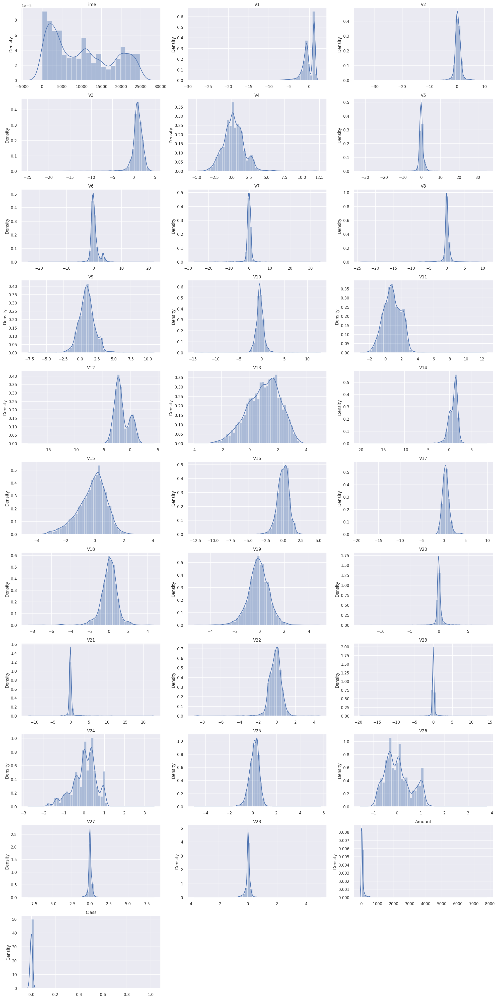

In [ ]:
# Checking for outliers using dist plot

plt.figure(figsize=(20, 40))

for col in train_df.select_dtypes(include=['number']).columns:
    plt.subplot(11, 3, train_df.columns.get_loc(col) + 1)  # Adjust the subplot layout as needed
    sns.distplot(x=train_df[col])
    plt.title(col)

plt.tight_layout()
plt.show()

##### From the above plots we can see that
- Columns V2, V3, V4, V7, V9, V10, V11, V12, V13, V16 and V17 seem to be significant
- We also see a few outliers throughout the dataset
- There seems to be skewness throughout

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

KeyboardInterrupt: ignored

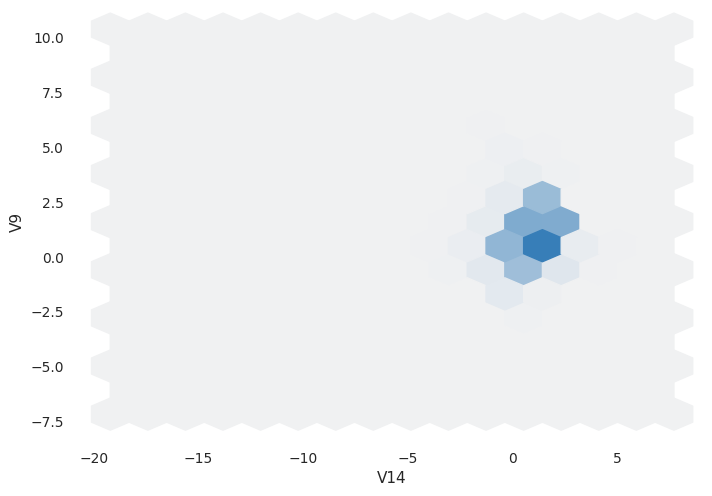

In [111]:
# Avanced EDA - Using Pandas Profiling

prof = ProfileReport(train_df)
prof.to_file(output_file = "/EDA - Fraudulant ATM Transactions.html")

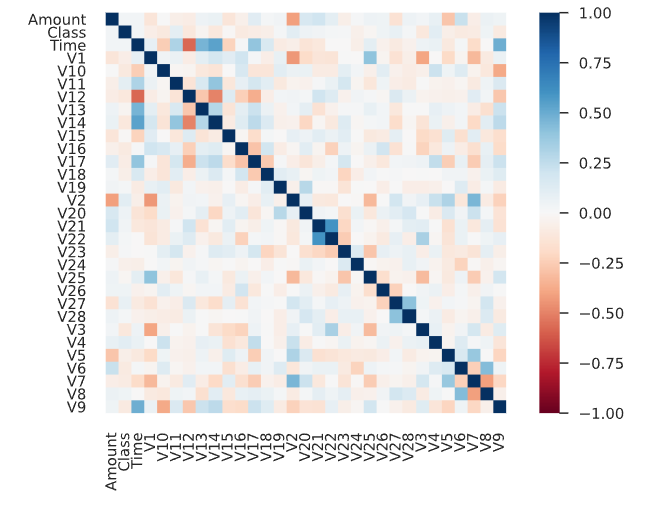

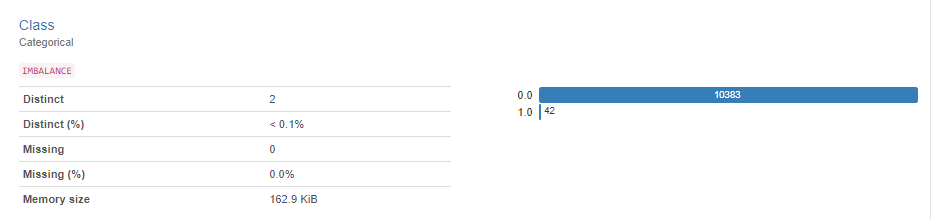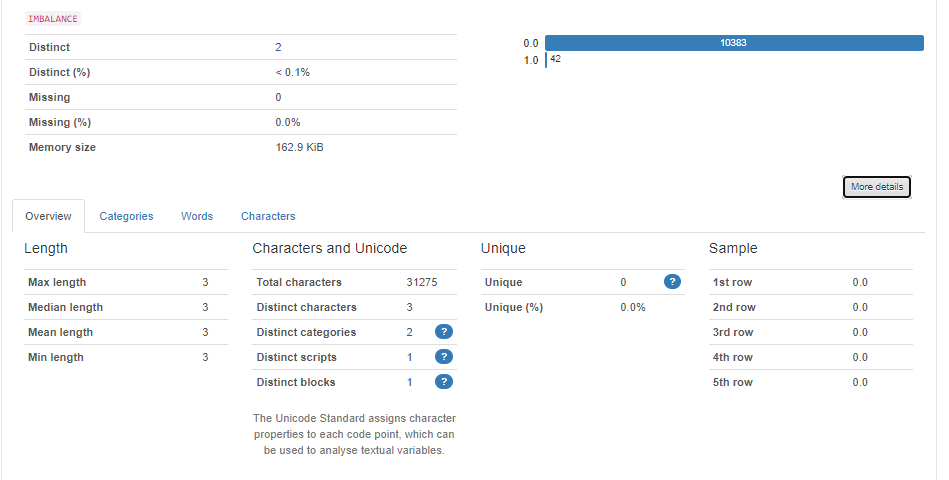

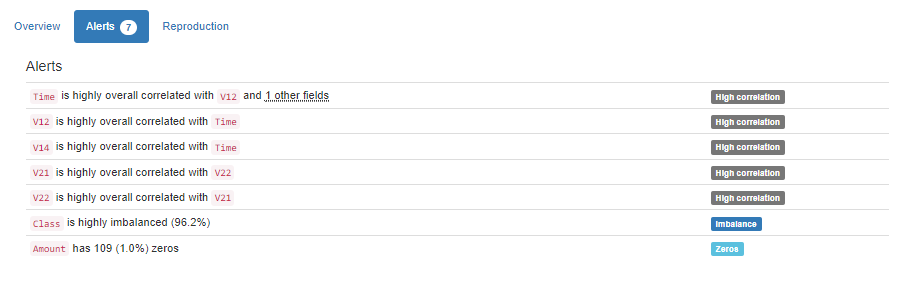

In [ ]:
@jit(target_backend='cuda')
def pp():
  sns.pairplot(train_df)

pp()

- Pandas Profiling and pairplot confirms the above observations
- Additionally we can observe the below
  - There is very high data imbalance
  - There is high negative correlation between 'Time', 'V12' and 'V14'
  - There is a high correlation between 'V21' and 'V22'
  - There is no corellation greater that 75% in the dataset
  - There is no high auto corellation
  - If we have any computational issue, we can reduce the correlated features.

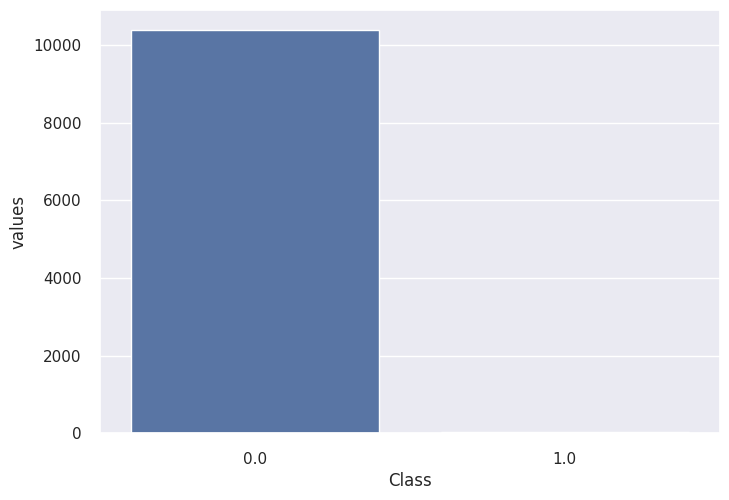

In [114]:
# Visualising the data imbalance

temp = train_df['Class'].value_counts()    # Counts the number of ones and zeroes in the column
temp_df = pd.DataFrame({'Class' : temp.index, 'values' : temp.values})    # Creating a data frame with value and their counts
sns.barplot(x = 'Class', y = 'values', data = temp_df)
plt.show()

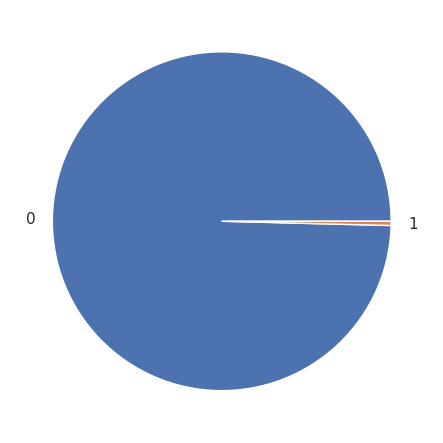

In [115]:
plt.pie(temp_df['values'], labels = [0, 1])
plt.show()

In [116]:
print("Ratio of fraudulent to genuine transactions is : ", temp_df.loc[1][1]/temp_df.loc[0][1])

Ratio of fraudulent to genuine transactions is :  0.004045073678127709


- We can see a clear data imbalance that needs to treated.

#### Using random over sampling to treat the data imbalance

In [118]:
# Doing the XY split to split the dependent and independent variables

train_features_df = train_df.iloc[:,:-1]
train_target_df = train_df.iloc[:,-1]

validation_features_df = validation_df.iloc[:,:-1]
validation_target_df = validation_df.iloc[:,-1]

train_features_df.columns

Index(['Time', 'V1', 'V2', 'V3', 'V4', 'V5', 'V6', 'V7', 'V8', 'V9', 'V10',
       'V11', 'V12', 'V13', 'V14', 'V15', 'V16', 'V17', 'V18', 'V19', 'V20',
       'V21', 'V22', 'V23', 'V24', 'V25', 'V26', 'V27', 'V28', 'Amount'],
      dtype='object')

In [119]:
train_target_df.head(2)

4413     0.0
11646    0.0
Name: Class, dtype: float64

In [120]:
validation_features_df.columns

Index(['Time', 'V1', 'V2', 'V3', 'V4', 'V5', 'V6', 'V7', 'V8', 'V9', 'V10',
       'V11', 'V12', 'V13', 'V14', 'V15', 'V16', 'V17', 'V18', 'V19', 'V20',
       'V21', 'V22', 'V23', 'V24', 'V25', 'V26', 'V27', 'V28', 'Amount'],
      dtype='object')

In [121]:
validation_target_df.head(2)

6720    0.0
9385    0.0
Name: Class, dtype: float64

In [122]:
print(train_features_df.shape, validation_features_df.shape, train_target_df.shape, validation_target_df.shape)

(10425, 30) (3475, 30) (10425,) (3475,)


In [123]:
# Oversampling of train data using Random Over Sampling Technique

over = RandomOverSampler()
ovrsam_train_features, ovrsam_train_target = over.fit_resample(train_features_df, train_target_df)

In [128]:
# After oversampling

print("Shape : ", ovrsam_train_features.shape, ovrsam_train_target.shape)
print("Value counts : ", ovrsam_train_target.value_counts())

Shape :  (20766, 30) (20766,)
Value counts :  0.0    10383
1.0    10383
Name: Class, dtype: int64


- The training dataset is balanced now.